<a href="https://www.kaggle.com/code/abdalrhamnhebishy/industrial-equipment-2?scriptVersionId=213551227" target="_blank"><img align="left" alt="Kaggle" title="Open in Kaggle" src="https://kaggle.com/static/images/open-in-kaggle.svg"></a>

In [1]:
from IPython.core.display import HTML

# Apply styles globally within the notebook
HTML('''
<style>
  h2 {
    font-size: var(--j3p-content-font-size4);
    background-color:lime;
    color: red;
    display: flex;
    align-items: center;
    justify-content: center;
    padding: 10px 41px;
    top: 10px;
    position: relative;
    border-radius: 10px 50px 10px 50px;
}

 img {       /* flex-grow: 1; */
            /* flex-shrink: 1; */
            border-radius: 100px 70px 150px 70px; 
            border: 10px solid #eee;
            display: flex;
            align-items: center;
            justify-content: center;
            transition: box-shadow 0.3s ease; /* Add a transition for a smooth effect */
        }

       img:active {
          box-shadow: 0 10px 20px rgba(173, 216, 230, 1) 0 6px 6px rgba(0, 0, 255, 1.0
173, 216, 230, 1);
        }
video {
    width: 820px; /* Set the width of the video */
    height: auto; /* Adjust the height automatically */
    border-radius: 25px; /* Add a border radius for rounded corners */
    border: 5px solid #eee; /* Add a border */
    box-shadow: 0 10px 20px rgba(173, 216, 230, 1), 0 6px 6px rgba((0, 0, 255, 1.0)); /* Add a box shadow */
    display: flex;
    controls: autoplay;
    align-items: center;
    justify-content: center;
    transition: box-shadow 0.3s ease; /* Add a transition for a smooth effect */
  }

  video:active {
    box-shadow: 0 10px 20px rgba(173, 216, 230, 1), 0 6px 6px rgba();
  }


</style>
''')  

## Industrial Equipment 🖥️Monitoring 🖲️ 

<img src="https://storage.googleapis.com/kaggle-datasets-images/6248517/10125778/5a9aa366ea0232b3bb734da24b022a0b/dataset-cover.png?t=2024-12-07-06-11-14" alt="My Image">

## Table of Contents 📝📝 

<div style="border: 2px solid red; padding: 10px; background-color: #F5F5F5; color: black; border-radius: 30px 45px 30px 45px;">

   
    
    
<p> &bull;        <a target="_blank"> Introudction</a>  </p> 

<p> &bull;      <a target="_blank"> Explanory Data Analysis</a>  </p>

<p>&bull;       <a target="_blank"> Data Processing</a>  </p>

<p>&bull;       <a target="_blank"> Model Bulding</a> </p>   
    
<p>&bull;       <a target="_blank"> Evalution Metrics </a> </p> 

<p>&bull;       <a target="_blank"> Results & see the best models </a> </p>   

</div>

## Data Information 📥📨

<div style="border: 2px solid red; padding: 10px; background-color: #F5F5F5; color: black; border-radius: 30px 45px 30px 45px;">


<p>&bull; 
Industrial Equipment Monitoring  Classification Dataset <p>

<p>&bull; This dataset contains simulated data representing real-time monitoring of various industrial equipment, including turbines, compressors, and pumps. Each row in the dataset corresponds to a unique observation capturing key parameters such as temperature, pressure, vibration, and humidity. The dataset also includes information about the equipment type, location, and whether the equipment is classified as faulty.</p>

<p>&bull;Additional Information :

The dataset consists of 10 000 data points stored as rows with 7 features in columns.</p>

<p>&bull; Target : faulty</p>
<p>&bull; faulty : take 1 or 0</p>

<p>&bull; <a href="https://www.kaggle.com/datasets/dnkumars/industrial-equipment-monitoring-dataset" target="_blank">Data Source Kaggle:</a></p>


</div>

## Understand the problem 🧠🧠🧐








<div style="border: 2px solid red; padding: 10px; background-color: #F5F5F5; color: black; border-radius: 30px 45px 30px 45px;">

<p> &bull; This problem Consider as binary Classification problrm   .</p> 

<p> &bull; Target of this problem to predict on  faulty  Column and classify if faulty or Not   .</p> 


<p> &bull; I will Train 7 models for Machine learning with visualization of them. (SportVectorMachine,RandomForestClassifier,Decision Tree Classifier,gradient boosting classifier,LogisticRegression,KneighoursClassifier .</p> 

<p>&bull; Also i will Make Explanory Analysis for the Data By using both SQL & Pandas  </p>

<p>&bull; Also i will learn the Relations between the Feature to  Make Different Plots that Represent the Data  </p>   
    
</div>

| Data fields      | Description                                                                                                 |
| ------------- | ----------------------------------------------------------------------------------------------------------- |
| temperature:            | Temperature reading at the time of observation (in °C).                                                                                   |
| pressure:          |   Pressure reading at the time of observation (in bar).                  |
| vibration:  | Vibration level reading (normalized units).                                                                           |
| humidity:           |  Humidity percentage recorded at the location of the equipment.                                                                                           |
| equipment:  | Type of industrial equipment being monitored (e.g., Turbine, Compressor, Pump).                                                    |
| location:        |  Location of the equipment (city name).                                                                          |
| faulty (Target):          | Binary indicator (0 = Not Faulty, 1 = Faulty) to specify whether the equipment is functioning properly or requires maintenance.                                                                                  |
|      
                  


                  






                                              

## imports 📥📥

In [43]:
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import graphviz
from sklearn.preprocessing import StandardScaler,OneHotEncoder,LabelEncoder,MinMaxScaler
from sklearn.compose import ColumnTransformer
from mlxtend.feature_selection import SequentialFeatureSelector as SFS
from sklearn.model_selection import train_test_split,GridSearchCV,cross_val_score,KFold,RandomizedSearchCV
from sklearn.ensemble import RandomForestClassifier,GradientBoostingClassifier
from sklearn.datasets import make_classification
from sklearn import svm
from sklearn.tree import DecisionTreeClassifier
from sklearn import metrics
from sklearn.metrics import classification_report,confusion_matrix ,roc_auc_score,ConfusionMatrixDisplay,accuracy_score,precision_score,recall_score,f1_score,precision_recall_curve
from sklearn.metrics import mean_squared_error
from sklearn import tree
from sklearn.linear_model import LogisticRegression
from sklearn.impute import SimpleImputer
import sqlite3
import folium
from folium.plugins import MarkerCluster
from sklearn.neighbors import KNeighborsClassifier
from plotly.graph_objs import *
import plotly.express as px 
import plotly.graph_objects as go
from plotly.subplots import make_subplots
from sklearn.pipeline import Pipeline
from hyperopt import fmin, tpe, hp, Trials
import warnings
from IPython.display import IFrame
from plotly.offline import plot

# Suppress all warnings
warnings.filterwarnings('ignore')



In [3]:
# load the data:

data=pd.read_csv("equipment_anomaly_data.csv")
data.head(25)

,temperature,pressure,vibration,humidity,equipment,location,faulty
0,58.180180,25.029278,0.606516,45.694907,Turbine,Atlanta,0.0
1,75.740712,22.954018,2.338095,41.867407,Compressor,Chicago,0.0
2,71.358594,27.276830,1.389198,58.954409,Turbine,San Francisco,0.0
3,71.616985,32.242921,1.770690,40.565138,Pump,Atlanta,0.0
4,66.506832,45.197471,0.345398,43.253795,Pump,New York,0.0
5,49.510959,76.426729,4.809298,20.269692,Compressor,New York,1.0
6,66.903503,45.530759,1.548345,64.804922,Compressor,Houston,0.0
7,148.923369,22.214121,0.109819,39.944953,Turbine,San Francisco,1.0
8,50.403299,45.399899,2.231718,43.067667,Pump,Houston,0.0
9,63.886148,33.802912,1.139280,41.795515,Compressor,Atlanta,0.0


## Explore the Data 🔎🔍

In [4]:
#Default theme

plt.style.use('dark_background')
warnings.filterwarnings("ignore", category=UserWarning, message="findfont: Font family")


In [5]:
#get info about the dataset:
print(data.info())
print("-"*25)
# to know more about the shape of the dataset:
print("shape of the dataset -->>",np.shape(data))
print("Size of the dataset -->>",data.size)
print("-"*25)
# to know number od types of data :
print("Number of Types Data -->>\n",data.dtypes.value_counts())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7672 entries, 0 to 7671
Data columns (total 7 columns):
 #   Column       Non-Null Count  Dtype  
---  ------       --------------  -----  
 0   temperature  7672 non-null   float64
 1   pressure     7672 non-null   float64
 2   vibration    7672 non-null   float64
 3   humidity     7672 non-null   float64
 4   equipment    7672 non-null   object 
 5   location     7672 non-null   object 
 6   faulty       7672 non-null   float64
dtypes: float64(5), object(2)
memory usage: 419.7+ KB
None
-------------------------
shape of the dataset -->> (7672, 7)
Size of the dataset -->> 53704
-------------------------
Number of Types Data -->>
 float64    5
object     2
Name: count, dtype: int64


In [6]:
#get the statistical:

data.describe().T.style.background_gradient(cmap="Dark2")

,count,mean,std,min,25%,50%,75%,max
temperature,7672.000000,70.922478,16.200059,10.269385,62.777057,70.156900,77.568387,149.690420
pressure,7672.000000,35.738048,10.381593,3.620798,29.485682,35.227544,41.159913,79.887734
vibration,7672.000000,1.611809,0.728560,-0.428188,1.170906,1.533113,1.924700,4.990537
humidity,7672.000000,50.016574,11.841479,10.215077,42.612817,50.024744,57.340513,89.984718
faulty,7672.000000,0.099974,0.299985,0.000000,0.000000,0.000000,0.000000,1.000000


In [7]:
# get Types of features:

data.dtypes

temperature    float64
pressure       float64
vibration      float64
humidity       float64
equipment       object
location        object
faulty         float64
dtype: object

In [8]:
# know the number of every item in every column:

for col in data.columns:
    print(f"counts of items in {col} -->> \n {data[col].value_counts()}")
    print("-"*25)

counts of items in temperature -->> 
 temperature
58.180180     1
74.416626     1
38.295743     1
70.550029     1
138.942780    1
             ..
55.777463     1
58.528405     1
59.047295     1
69.634100     1
28.468054     1
Name: count, Length: 7672, dtype: int64
-------------------------
counts of items in pressure -->> 
 pressure
25.029278    1
17.240087    1
46.951425    1
28.575323    1
21.069370    1
            ..
45.262360    1
27.829333    1
35.623498    1
21.504984    1
66.588978    1
Name: count, Length: 7672, dtype: int64
-------------------------
counts of items in vibration -->> 
 vibration
0.606516    1
1.355001    1
1.699792    1
1.204313    1
3.359176    1
           ..
1.715007    1
1.336628    1
0.910241    1
0.831865    1
4.677368    1
Name: count, Length: 7672, dtype: int64
-------------------------
counts of items in humidity -->> 
 humidity
45.694907    1
56.253263    1
59.277159    1
47.462139    1
42.125386    1
            ..
69.149045    1
57.650272    1
41.

In [9]:
# to know the uniques values in evey column in the dataset:
for col in data.columns:
    print(f"All items in the ---->>>{col} column  : \n{data[col].unique()}")
    print("*"*50)

All items in the ---->>>temperature column  : 
[ 58.18018004  75.74071221  71.35859424 ...  72.02923021 107.08648487
  28.4680537 ]
**************************************************
All items in the ---->>>pressure column  : 
[25.02927765 22.9540176  27.27683032 ... 34.75789554 23.75411416
 66.58897816]
**************************************************
All items in the ---->>>vibration column  : 
[0.60651622 2.33809475 1.3891983  ... 1.70904571 1.14252179 4.67736772]
**************************************************
All items in the ---->>>humidity column  : 
[45.6949071  41.86740679 58.95440891 ... 49.97291673 23.96797749
 79.67022502]
**************************************************
All items in the ---->>>equipment column  : 
['Turbine' 'Compressor' 'Pump']
**************************************************
All items in the ---->>>location column  : 
['Atlanta' 'Chicago' 'San Francisco' 'New York' 'Houston']
**************************************************
All items in the --

In [10]:
# Extract all Types of columns from the data :
for col in data.columns:
    obj_cols=data.select_dtypes("object").columns

    num_cols=data.select_dtypes("number").columns

    disc_cols=data.select_dtypes(include=("int64")).columns

    conts_cols=data.select_dtypes(include=("float64")).columns

    Nomial_cols=data.nunique()[data.nunique()<3]

print(f"object_columns ----->>> {obj_cols}\n Numerical_columns ----->>> {num_cols} \n Discrete_columns ---->>> {disc_cols} \n Continous_cols ----->> {conts_cols} \n Nominal Columns --->> {Nomial_cols}")

object_columns ----->>> Index(['equipment', 'location'], dtype='object')
 Numerical_columns ----->>> Index(['temperature', 'pressure', 'vibration', 'humidity', 'faulty'], dtype='object') 
 Discrete_columns ---->>> Index([], dtype='object') 
 Continous_cols ----->> Index(['temperature', 'pressure', 'vibration', 'humidity', 'faulty'], dtype='object') 
 Nominal Columns --->> faulty    2
dtype: int64


## Cleaning 🧹🧹 







<div style="border: 3px solid yellow; padding: 10px; background-color: #F5F5F5; color: black; border-radius: 30px 45px 30px 45px;">

<p> &bull; At First i checked if ound any Null Values . </p> 


<p> &bull; I checked Duplicates values & Remove it if ound . </p>


<p> &bull; I used the Simple Imputer Method to fill the Null Values if it was very big . </p> 

<p> &bull; I used median Strategy with Numerical Features  .</p> 

<p> &bull; I make Reshape , then i make squeeze on it  . </p>

<p> &bull; Any Column , Rate of missing values Reach above 75% ,Delete it  . </p>

<p>  👉🏻 &bull; Data are Cleaned from Any Null values .  . </p>

</div>








In [11]:
# check the Null Values :
# ok there no Any Null values :

data.isna().mean()

temperature    0.0
pressure       0.0
vibration      0.0
humidity       0.0
equipment      0.0
location       0.0
faulty         0.0
dtype: float64

In [12]:
# Drop any null values if found :
df = data.dropna()
df.isna().mean()

temperature    0.0
pressure       0.0
vibration      0.0
humidity       0.0
equipment      0.0
location       0.0
faulty         0.0
dtype: float64

In [13]:
# Check if there are aduplicated values in the data & drop it if found :
duplicated_features=df.duplicated().sum()
print("Number of duplicates ----->>> ",duplicated_features)
df = df.drop_duplicates()
duplicated_features=df.duplicated().sum()
print("Number of duplicates of cleaning it ----->>> ",duplicated_features)

Number of duplicates ----->>>  0
Number of duplicates of cleaning it ----->>>  0


## Explanory on Dataset: 




<div style="border: 5px solid yellow; padding: 10px; background-color: #F5F5F5; color: black; border-radius: 30px 45px 30px 45px;">

<p> &bull; Contex : </p> 

<p> &bull; Correlation : I make correlation to study Relations between features </p> 

<p> &bull; outliers : Defination outliers and check on each feature   .</p> 
<p> &bull; outliers : see percentage of every outliers at any column and how dealing with it    .</p> 

<p> &bull; heatmap : very strong plot that show the Strong / week Relations between features   .</p> 
</div>

In [14]:
# Calculate the correlation :

corr=df.select_dtypes("number").corr()
corr

,temperature,pressure,vibration,humidity,faulty
temperature,1.000000,0.049093,0.063448,0.000376,0.184296
pressure,0.049093,1.000000,0.077577,-0.014706,0.202285
vibration,0.063448,0.077577,1.000000,0.025175,0.431409
humidity,0.000376,-0.014706,0.025175,1.000000,0.012652
faulty,0.184296,0.202285,0.431409,0.012652,1.000000


In [15]:
data.columns

Index(['temperature', 'pressure', 'vibration', 'humidity', 'equipment',
       'location', 'faulty'],
      dtype='object')

In [16]:
corr_matrix = df.select_dtypes("number").corr()
fig4 = px.imshow(corr_matrix, text_auto=True, title="Correlation Heatmap")
filename="corr.html"
plot(fig4, filename=filename, auto_open=False)
display(IFrame(filename, width=800, height=800))

## Defination Outliers 

In [17]:
# found many feature contain the outliers  :
features=df.select_dtypes(include="number").columns

for col in features:
    Q1_col,Q3_col=df[col].quantile([0.25,0.75])
    iqr=Q3_col-Q1_col
    low_limit=Q1_col-1.5*iqr
    upper_limit=Q3_col+1.5*iqr
    outlier=[]
    for x in df[col]:
         if ((x> upper_limit) or (x<low_limit)):
             outlier.append(x)
    if len(outlier)==0:
        print(f" * -- >> there No outlier in {col} feature")
    else:
        print(f"Ther outlier in this feature {col}")

    print(f"Q1 of {col} --->>> {Q1_col} \n Q3 of {col} ---->>> {Q3_col} \n iqr--->>{iqr}\n low_limit--->>>{low_limit} \n  upper_limit--->>> {upper_limit} \n outlier---->>> {outlier} \n Number of outliers --->>> {len(outlier)} ")
    print("-"*90)
    

Ther outlier in this feature temperature
Q1 of temperature --->>> 62.777056523801136 
 Q3 of temperature ---->>> 77.56838664151574 
 iqr--->>14.791330117714608
 low_limit--->>>40.59006134722922 
  upper_limit--->>> 99.75538181808766 
 outlier---->>> [148.92336873207364, 141.26030984408388, 117.25565678109554, 135.30440061610966, 15.905622342629414, 128.68673398905372, 140.48797277487645, 120.85588955758838, 107.20136172814424, 36.4810056497079, 27.75880600254094, 13.709622907778318, 22.27105033128577, 112.99665489609612, 112.78221826032777, 117.16076125764364, 131.4206923961483, 112.53463791732108, 104.47639731695436, 18.534630261591687, 101.7041972819861, 118.4449549882954, 136.8441449184553, 124.35863656211068, 106.78920406471175, 31.52955881688417, 140.19472568890708, 23.52007189650115, 128.13233589409057, 101.52056734512084, 140.37751130333112, 102.40459182955844, 116.23211880227356, 27.682863992377364, 13.901767992593836, 19.051816782081705, 122.98582559343484, 10.269384763629008,

In [18]:
columns=["humidity","temperature","vibration","pressure"]
for col in columns :
    fig2 = px.box(df, y=df[col],color='equipment', title=col + "Distribution")
    filename="box.html"
    plot(fig2, filename=filename, auto_open=False)
    display(IFrame(filename, width=800, height=600))
    print("="*100)

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


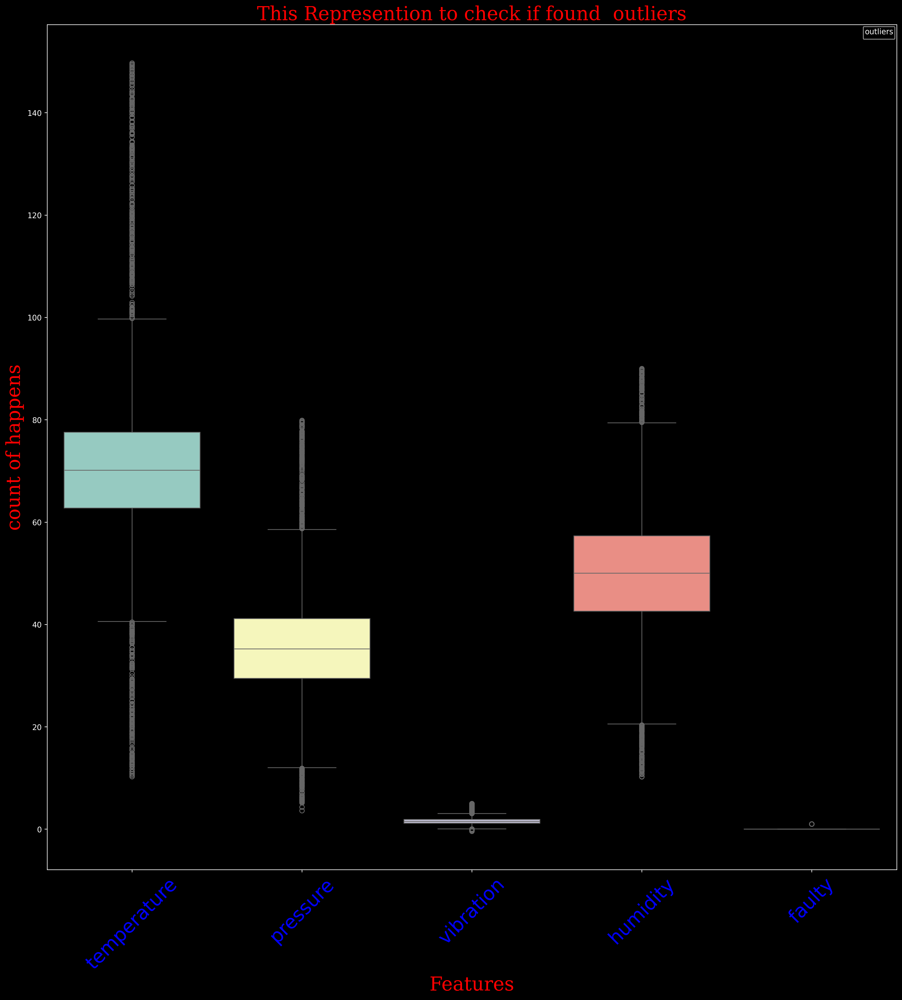

In [19]:
# from this Represention we discover that we found outliers :

f1={"family":"serif","size":25,"color":"r"}
plt.figure(figsize=(20,20),dpi=250)
plt.title("This Represention to check if found  outliers",fontdict=f1)
plt.xlabel("Features",fontdict=f1)
plt.ylabel("count of happens",fontdict=f1)
plt.xticks(rotation=45,color="b",fontsize=25)
sns.boxplot(df[features])
plt.legend(title="outliers",prop={'size': 5})

## Visualization 📊📈📉 

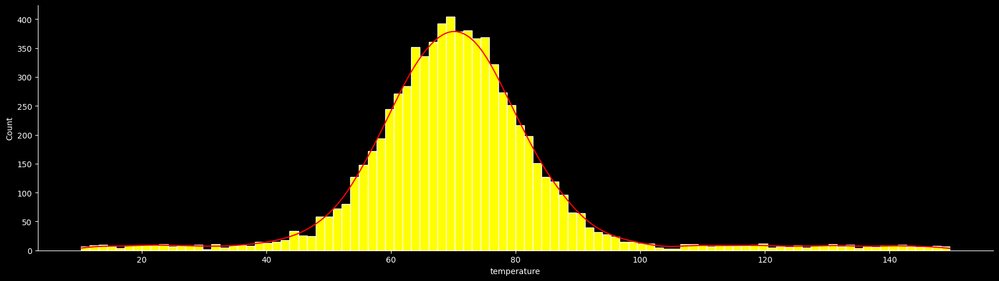

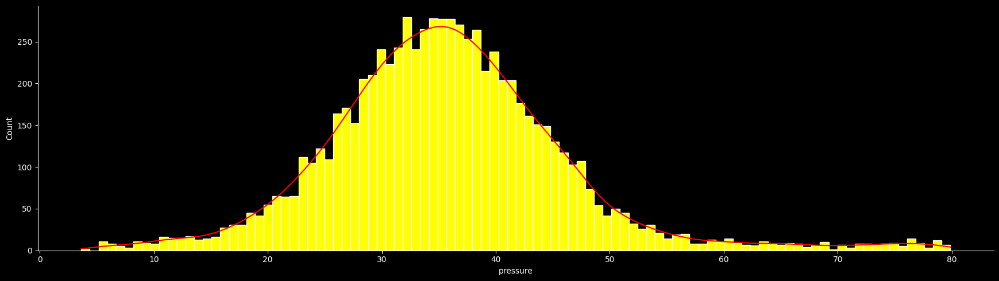

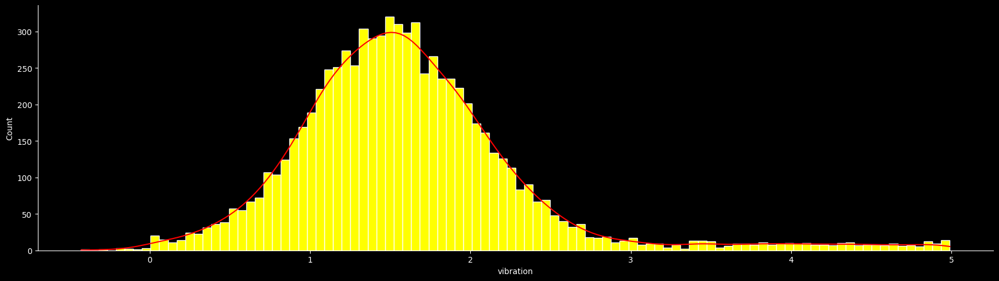

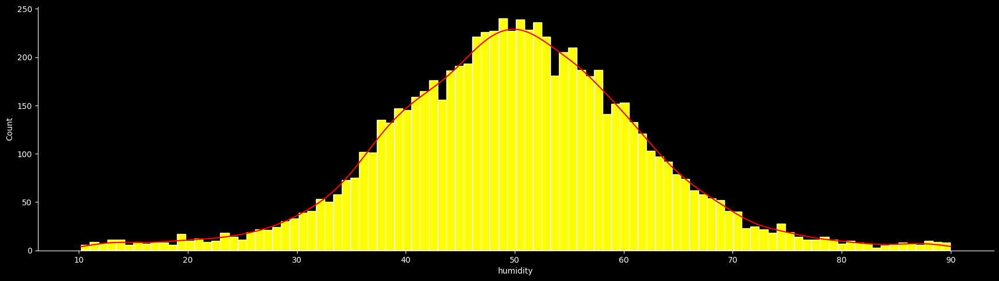

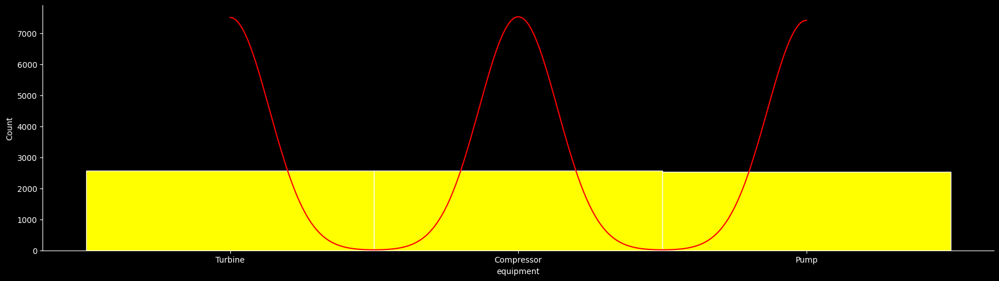

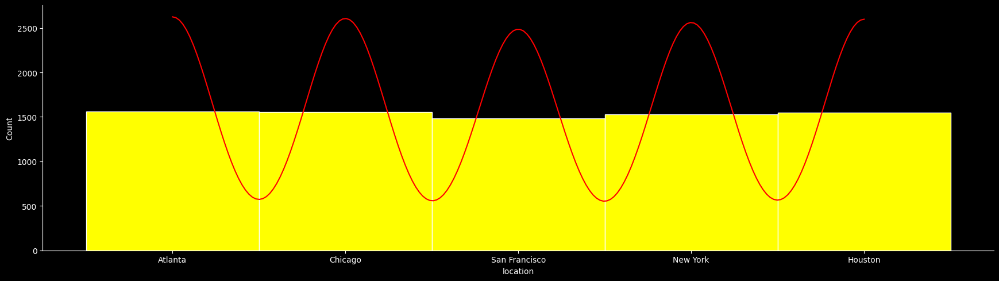

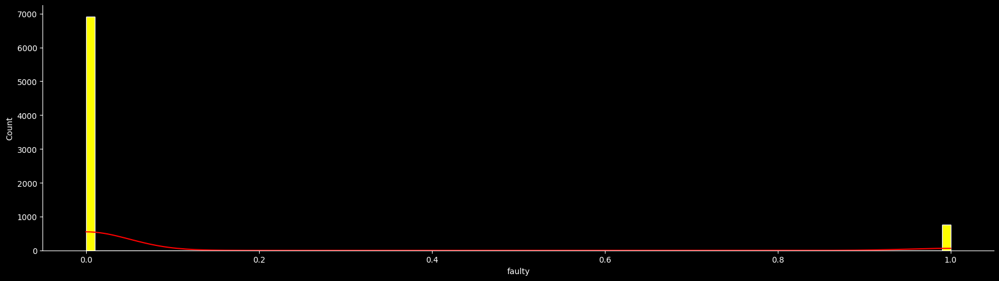

In [20]:
for col in df.columns:
    sns.displot(df, x=df[col], kde=True, bins = 100,color = "red", facecolor = "yellow",height = 5, aspect = 3.5);
    

In [21]:
df.columns

Index(['temperature', 'pressure', 'vibration', 'humidity', 'equipment',
       'location', 'faulty'],
      dtype='object')

No Relation:


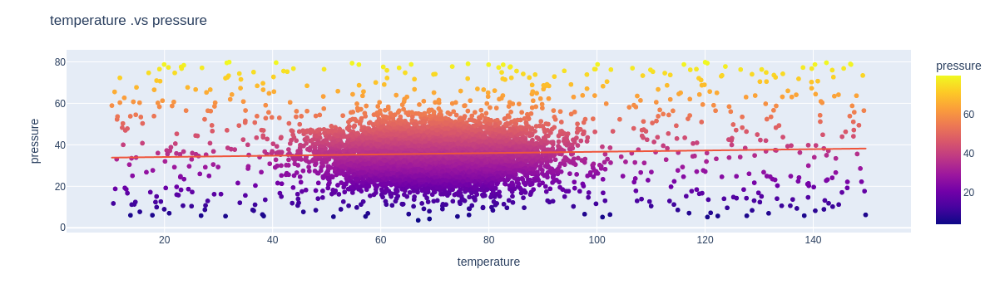

No Relation :


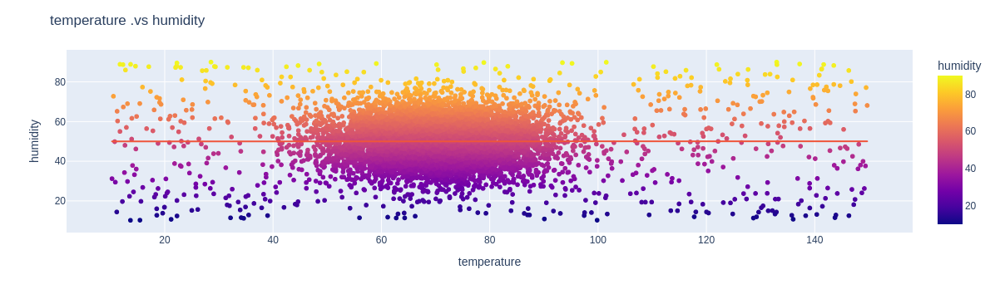

In [22]:
color_palette = ['#00FF00', '#DFFF00', '#228B22', '#808000', '#2E8B57', '#008080']

# Observation  between  of temperature  & pressure   :

print("No Relation:")
fig = px.scatter(df, x='temperature', y='pressure', color='pressure', color_discrete_sequence=color_palette,trendline='ols')
fig.update_layout(title="temperature .vs pressure", xaxis_title="temperature", yaxis_title="pressure")
fig.show()
print("="*75)

# Observation  between  of temperature  & humidity   :

print("No Relation :")
fig = px.scatter(df, x='temperature', y='humidity', color='humidity', color_discrete_sequence=color_palette,trendline='ols')
fig.update_layout(title="temperature .vs humidity", xaxis_title="temperature", yaxis_title="humidity")
fig.show()




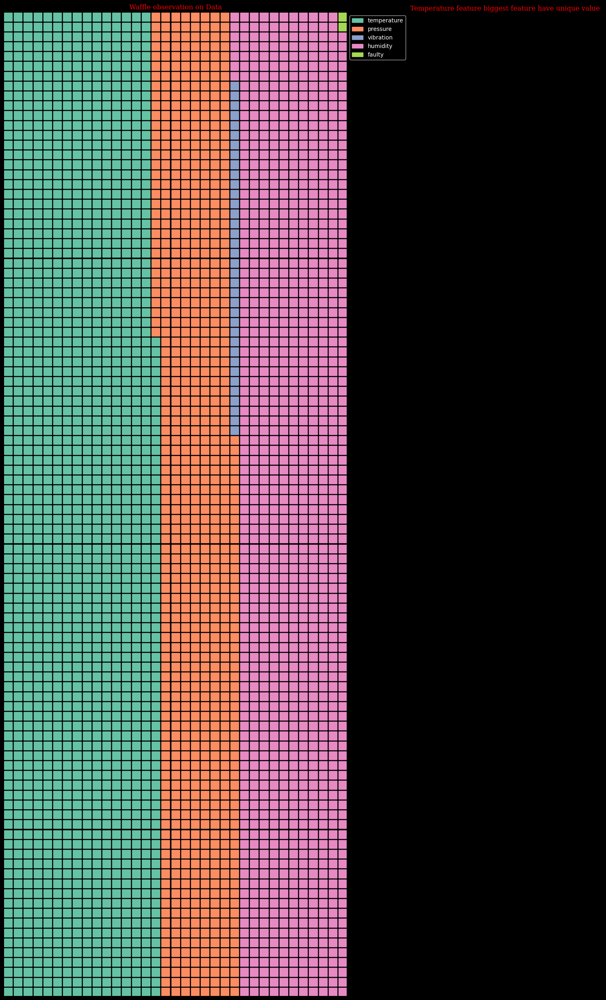

In [23]:
# Make a waffel for the Data:
# from this waffle i see which Feature is a controled on other features : 


f2 = {"family": "serif", "size": 12, "color": "r"}

from pywaffle import Waffle

numeric_columns = df.select_dtypes(include=['int64', 'float64']).columns
values = df[numeric_columns].sum().tolist()

fig = plt.figure(
    FigureClass=Waffle,
    rows=100,
    columns=35,
    values=values,
    legend={'labels': numeric_columns.tolist(),
            'loc': "upper left",
            'bbox_to_anchor': (1, 1)},
    figsize=(25, 25)
)
plt.title("Waffle observation on Data",fontdict=f2)
plt.suptitle("Temperature feature biggest feature have unique value ",fontdict=f2)
plt.show()

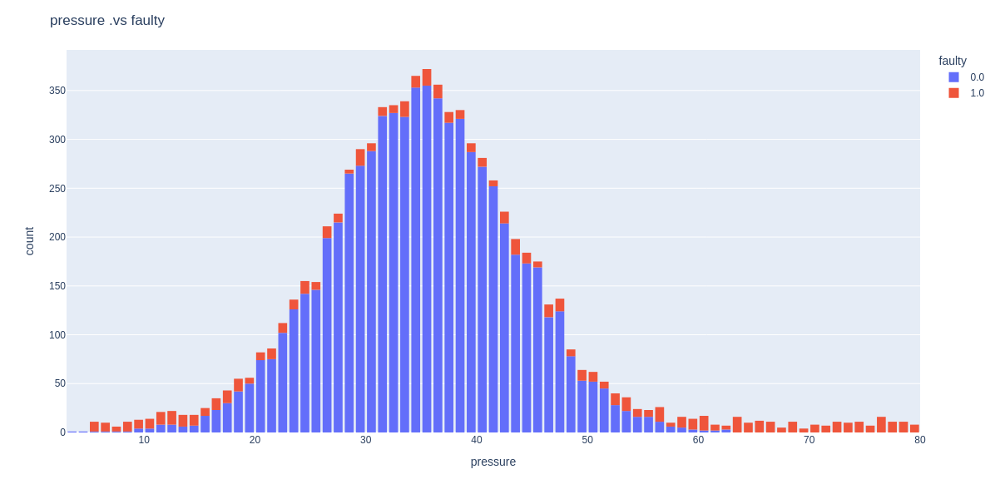

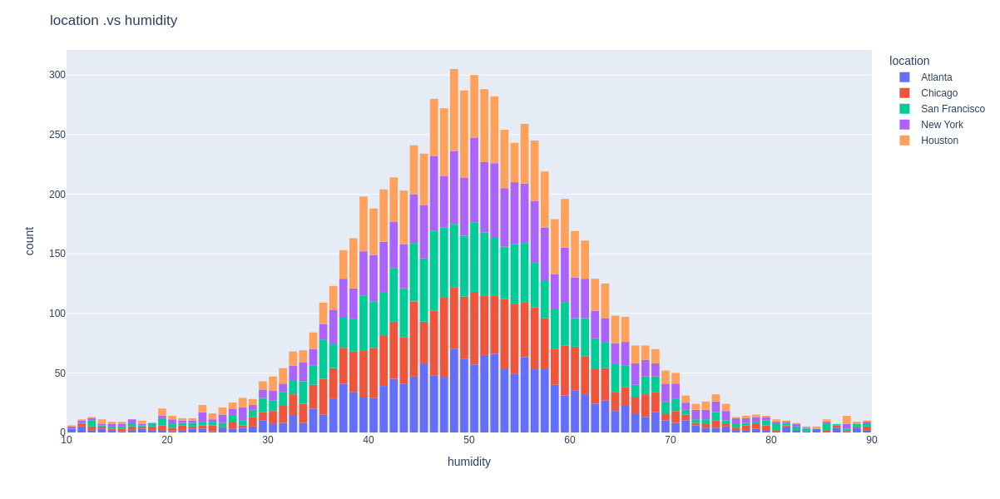

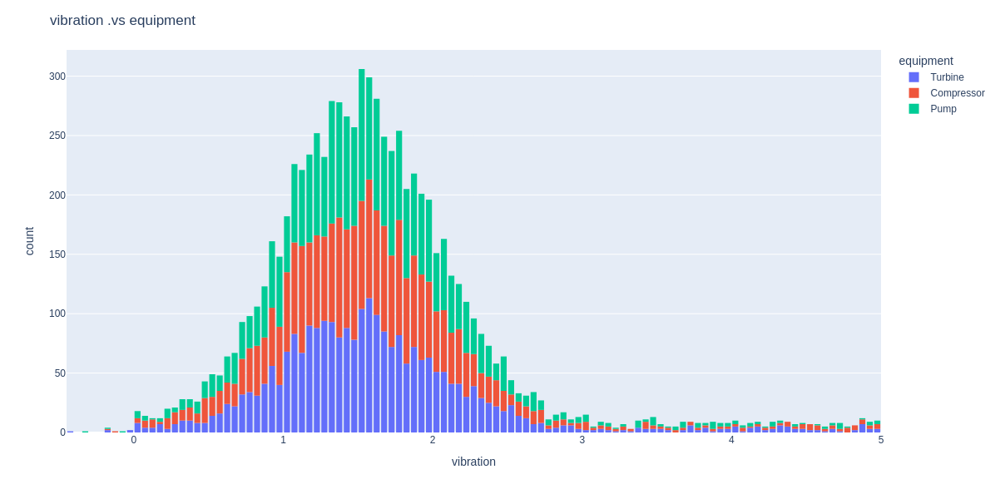

In [24]:
# Histogram that show how can see pressure with faulty  :

fig = px.histogram(df, x="pressure", color="faulty")
fig.update_layout(
    bargap=0.2,
    title="pressure .vs faulty",
    legend_title="faulty",
    width=800,  
    height=600  
)
fig.show()

print("="*75)

# Histogram that show location with humidity  :

fig = px.histogram(df, x="humidity", color="location")
fig.update_layout(
    bargap=0.2,
    title="location .vs humidity",
    legend_title="location",
    width=800,  
    height=600  
)
fig.show()

print("="*75)

# Histogram that show vibration with equipment  :

fig = px.histogram(df, x="vibration", color="equipment")
fig.update_layout(
    bargap=0.2,
    title="vibration .vs equipment",
    legend_title="equipment",
    width=800,  
    height=600  
)
fig.show()


Rates of faculty at every temperature:
 faulty
1.0    79.880024
0.0    69.927484
Name: temperature, dtype: float64


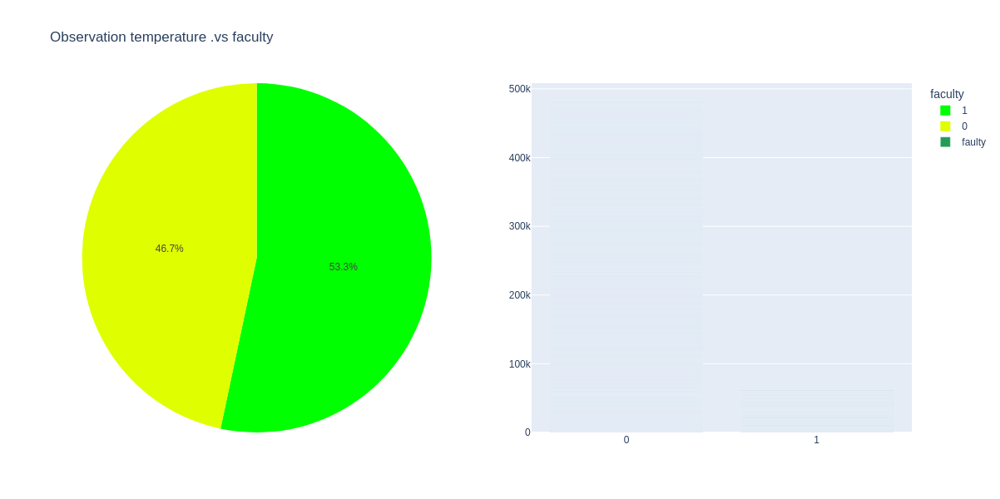

In [25]:
# Pie plot

color_palette = ['#00FF00', '#DFFF00', '#228B22', '#808000', '#2E8B57', '#008080']
faulty = df.groupby("faulty")["temperature"].mean().sort_values(ascending=False)
faulty_index = faulty.reset_index()

print("Rates of faculty at every temperature:\n", faulty)

fig = make_subplots(rows=1, cols=2, specs=[[{'type': 'pie'}, {'type': 'bar'}]])

# Add pie plot
fig.add_trace(go.Pie(labels=faulty_index['faulty'], values=faulty_index['temperature'], marker=dict(colors=color_palette)), row=1, col=1)

# Bar plot
fig.add_trace(go.Bar(name='faulty', x=df["faulty"], y=df["temperature"], marker_color="#239b56"), row=1, col=2)

# Update layout
fig.update_layout(
    title="Observation temperature .vs faculty",
    legend_title="faculty",
    width=1200,
    height=600,
    showlegend=True
)

# Show the plot
fig.show()

Rates of humidity at each location :
 location
Atlanta          50.407953
New York         50.385067
Houston          50.125985
San Francisco    49.620448
Chicago          49.529036
Name: humidity, dtype: float64


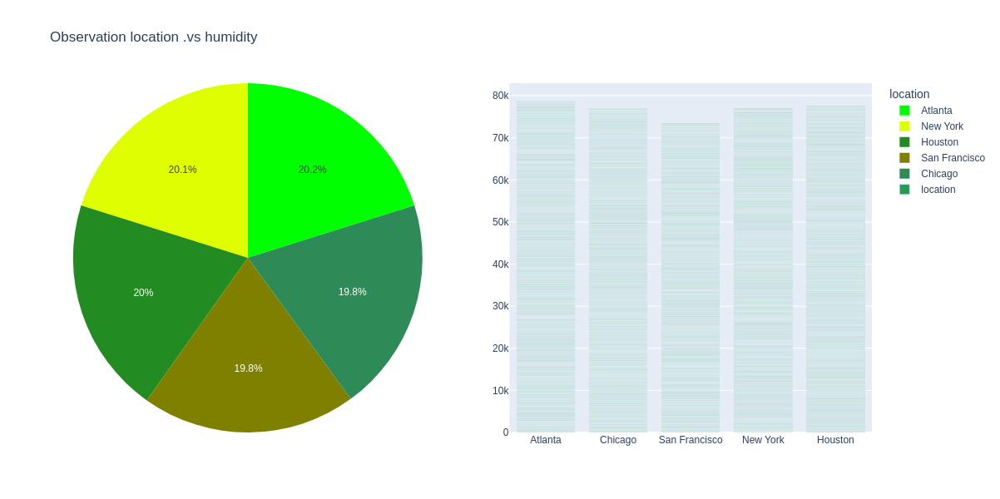

In [26]:
# Pie plot

color_palette = ['#00FF00', '#DFFF00', '#228B22', '#808000', '#2E8B57', '#008080']
location = df.groupby("location")["humidity"].mean().sort_values(ascending=False)
location_index = location.reset_index()

print("Rates of humidity at each location :\n", location)

fig = make_subplots(rows=1, cols=2, specs=[[{'type': 'pie'}, {'type': 'bar'}]])

# Add pie plot
fig.add_trace(go.Pie(labels=location_index['location'], values=location_index['humidity'], marker=dict(colors=color_palette)), row=1, col=1)

# Bar plot
fig.add_trace(go.Bar(name='location', x=df["location"], y=df["humidity"], marker_color="#239b56"), row=1, col=2)

# Update layout
fig.update_layout(
    title="Observation location .vs humidity ",
    legend_title="location",
    width=1200,
    height=600,
    showlegend=True
)

# Show the plot
fig.show()

In [27]:
df.columns

Index(['temperature', 'pressure', 'vibration', 'humidity', 'equipment',
       'location', 'faulty'],
      dtype='object')

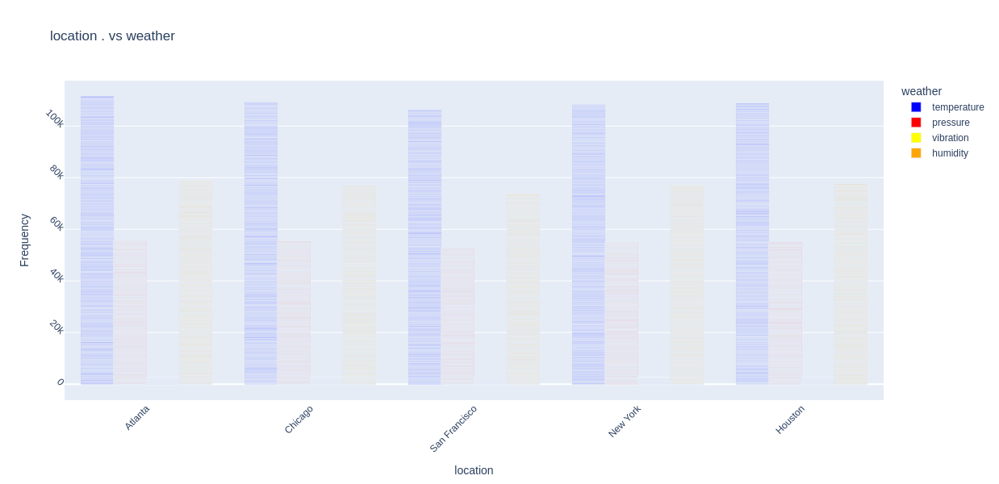

In [28]:
# whats the affect wheather on locations ?


x = df["location"]
y1 =df["temperature"]
y2 = df["pressure"]
y3=df["vibration"]
y4=df["humidity"]    

fig = go.Figure(data=[
        go.Bar(name='temperature', x=x, y=y1,marker_color="blue"),
        go.Bar(name='pressure', x=x, y=y2,marker_color="red"),
        go.Bar(name='vibration',x=x,y=y3,marker_color="yellow"),
        go.Bar(name='humidity',x=x,y=y4,marker_color="orange")
    ])
    
fig.update_layout(barmode='group',
                      title='location . vs weather ',
                      legend_title="weather",
                      width=800,  
                      height=600 ,       
                      xaxis_title="location",
                      yaxis_title="Frequency",
                      xaxis_tickangle=-45,
                      yaxis_tickangle=45
    ) 
    
fig.show()


In [29]:
city_coordinates = {
    "New York": [40.7128, -74.0060],
    "Houston": [29.7604, -95.3698],
    "Chicago": [41.8781, -87.6298],
    "San Francisco": [37.7749, -122.4194],
    "Atlanta": [33.7490, -84.3880]
}
data["city"] = data["location"] 
data["latitude"] = data["city"].map(lambda x: city_coordinates[x][0])
data["longitude"] = data["city"].map(lambda x: city_coordinates[x][1])
m = folium.Map(location=[37.0902, -95.7129], zoom_start=4)
marker_cluster = MarkerCluster().add_to(m)
for i, row in data.iterrows():
    folium.Marker(
        location=[row["latitude"], row["longitude"]],
        popup=f"City: {row['city']}, Equipment: {row['equipment']}"
    ).add_to(marker_cluster)

m

array([[<Axes: title={'center': 'temperature'}>,
        <Axes: title={'center': 'pressure'}>],
       [<Axes: title={'center': 'vibration'}>,
        <Axes: title={'center': 'humidity'}>],
       [<Axes: title={'center': 'faulty'}>, <Axes: >]], dtype=object)

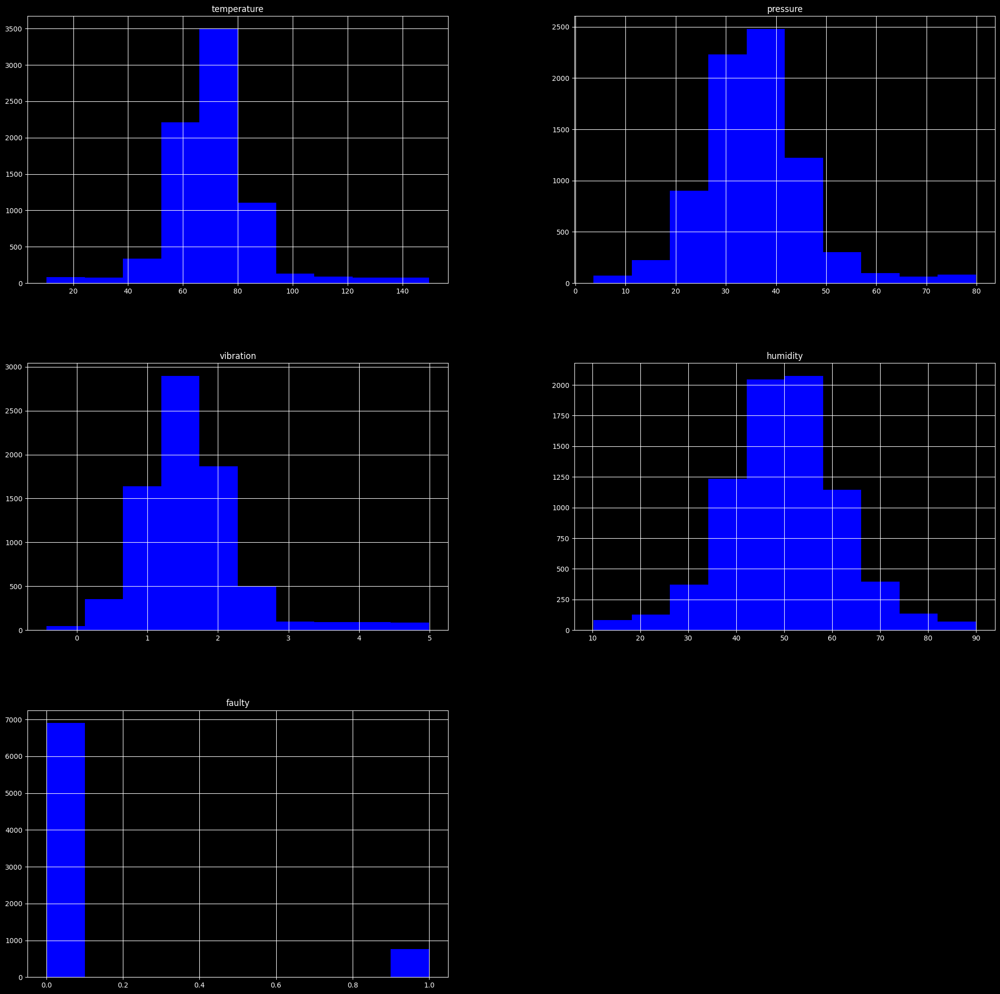

In [30]:
# plot the histgram:
df.hist(figsize=(25,25),color="b")

<Figure size 6250x6250 with 0 Axes>

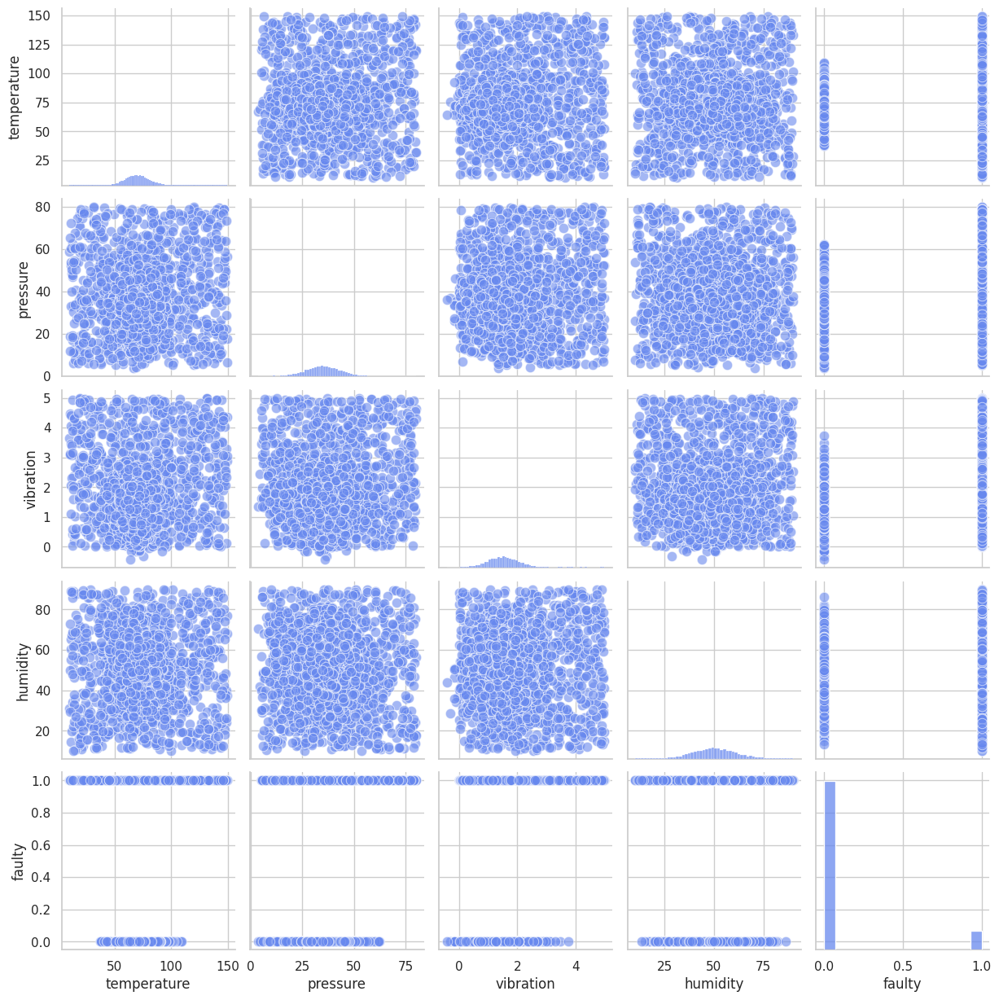

In [31]:
# observe for the float_data
plt.figure(figsize=(25, 25), dpi=250)
sns.set(style="whitegrid")  # Set the plot style
sns.set_palette("coolwarm")    # Set the color palette
sns.pairplot(df.select_dtypes("number"), plot_kws={'alpha': 0.6, 's': 80})

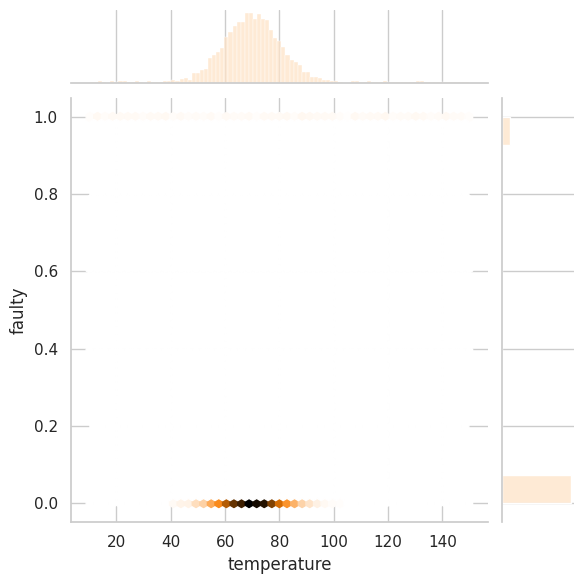

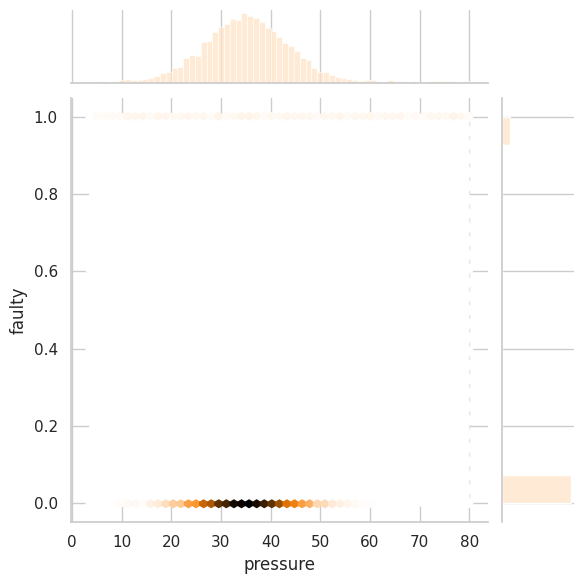

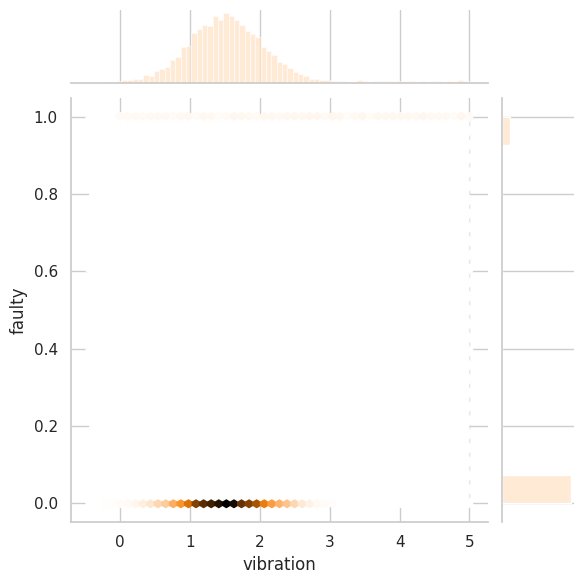

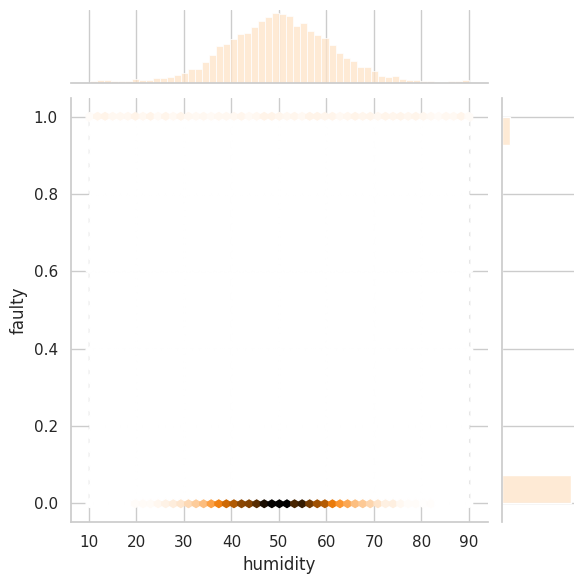

In [32]:
for col in df.select_dtypes("number"):
    if col !="faulty":
       with sns.axes_style("white"):
          sns.set(style="whitegrid")  # Set the plot style
          sns.set_palette("Oranges")    # Set the color palette
          sns.jointplot(x=df[col],y=df["faulty"],kind="hex")

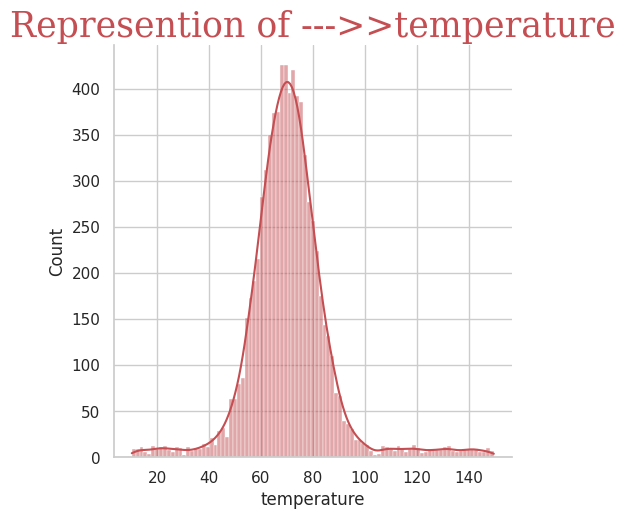

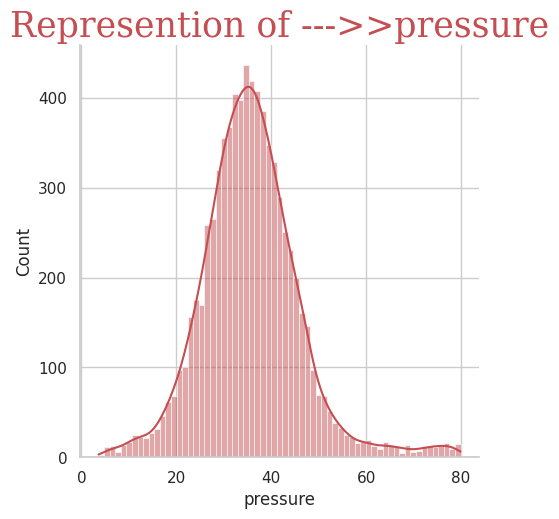

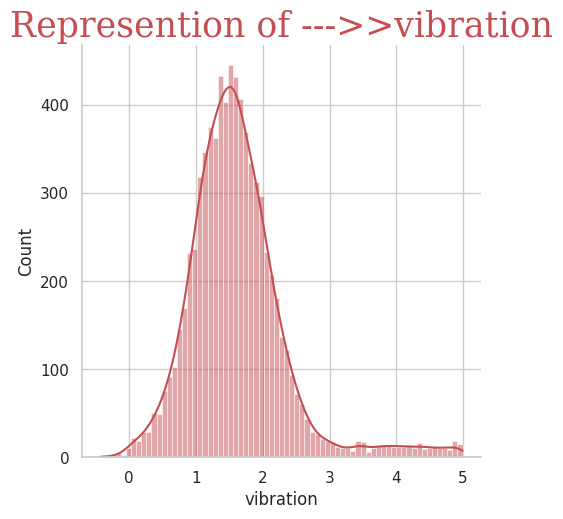

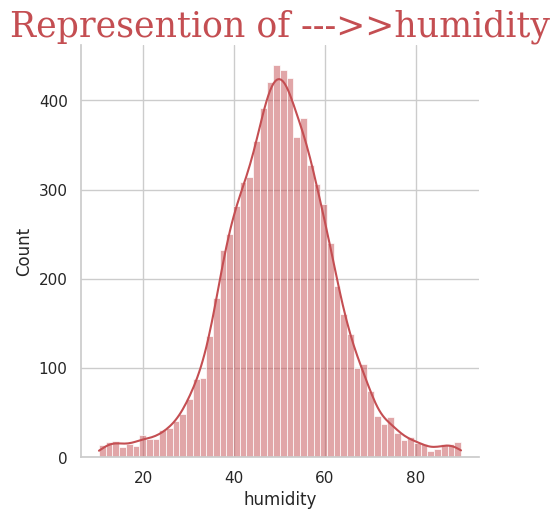

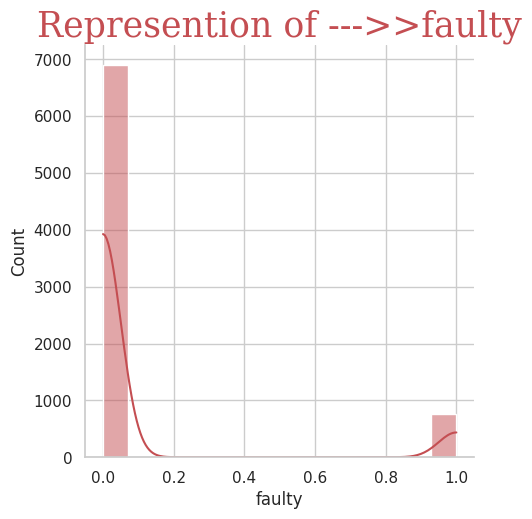

In [33]:
for col in df.select_dtypes("number").columns:
    sns.displot(df[col],kde=True,color="r",label=col)
    sns.set(style="whitegrid")  # Set the plot style
    sns.set_palette("coolwarm")    # Set the color palette
    plt.title("Represention of --->>"+col,fontdict=f1)

## Feature Selection 

In [34]:
# convert Categorical into Numerical :
# Convert all Categorical columns into Numerical columns :

label_encoder=LabelEncoder()
for col in df.columns:
    df[col]=label_encoder.fit_transform(df[col])
df

,temperature,pressure,vibration,humidity,equipment,location,faulty
0,1092,936,344,2613,2,0,0
1,5343,632,6894,1759,0,1,0
2,4168,1374,3021,6086,2,4,0
3,4238,2788,5090,1497,1,0,0
4,2825,6611,129,2060,1,3,0
...,...,...,...,...,...,...,...
7667,2631,4643,6162,3637,1,3,0
7668,1970,6599,2372,6606,1,3,0
7669,4362,3666,4797,3812,1,0,0
7670,7429,750,1783,167,0,0,1


In [35]:
# selecting numerical features :
numerical_features = df.select_dtypes(include=['number'])

scaler = MinMaxScaler()
scaled_numerical_features = scaler.fit_transform(numerical_features)

# Create a DataFrame from the scaled numerical features
scaled_numerical_df = pd.DataFrame(scaled_numerical_features, columns=numerical_features.columns)

scaled_numerical_df

,temperature,pressure,vibration,humidity,equipment,location,faulty
0,0.142354,0.122018,0.044844,0.340634,1.0,0.00,0.0
1,0.696519,0.082388,0.898709,0.229305,0.0,0.25,0.0
2,0.543345,0.179116,0.393821,0.793378,1.0,1.00,0.0
3,0.552470,0.363447,0.663538,0.195151,0.5,0.00,0.0
4,0.368270,0.861817,0.016817,0.268544,0.5,0.75,0.0
...,...,...,...,...,...,...,...
7667,0.342980,0.605267,0.803285,0.474123,0.5,0.75,0.0
7668,0.256811,0.860253,0.309217,0.861165,0.5,0.75,0.0
7669,0.568635,0.477904,0.625342,0.496937,0.5,0.00,0.0
7670,0.968453,0.097771,0.232434,0.021770,0.0,0.00,1.0


## Split Data for Classification :


<div style="border: 5px solid yellow; padding: 10px; background-color: #F5F5F5; color: black; border-radius: 30px 45px 30px 45px;">

<p> &bull; i split data into x_class & y_class </p> 

<p> &bull; x_class : refer into all Data Except faulty (1 or 0) </p> 

<p> &bull; y_class : refer into faulty (Target)</p> 

<p> &bull; then , iused train_test_split method to divide data into test , train</p> 
</div>


In [36]:
# split the data int train & test :

x_class,y_clss=make_classification(n_samples=100,random_state=42)

x_class=scaled_numerical_df.drop(columns="faulty",axis=1)
y_class=scaled_numerical_df["faulty"]

In [37]:
# train split of the Data
x_train,x_test,y_train,y_test=train_test_split(x_class,y_class,test_size=0.3,random_state=42)
print("x_train shape : ",x_train.shape)
print("x_test shape : ",x_test.shape)
print("y_train shape : ",y_train.shape)
print("y_test shape : ",y_test.shape)

x_train shape :  (5370, 6)
x_test shape :  (2302, 6)
y_train shape :  (5370,)
y_test shape :  (2302,)


## Bulding Classification Models (Traditional_models) :

<div style="border: 2px solid yellow; padding: 10px; background-color: #F5F5F5; color: black; border-radius: 30px 45px 30px 45px;">



<p> &bull; <span class="label label-default" style="background-color:#DC1010; border-radius:12px; font-weight: bold; font-family:Verdana; font-size:28px; color:#FBFAFC; ">LogisticRegression 📊📈</span>  </p> 

<p> &bull; <span class="label label-default" style="background-color:#DC1010; border-radius:12px; font-weight: bold; font-family:Verdana; font-size:28px; color:#FBFAFC; ">Decision Tree Classifier 🎄</span>  </p> 

<p> &bull;<span class="label label-default" style="background-color:#DC1010; border-radius:12px; font-weight: bold; font-family:Verdana; font-size:28px; color:#FBFAFC; ">SVM 📚</span>  </p> 

<p> &bull; <span class="label label-default" style="background-color:#DC1010; border-radius:12px; font-weight: bold; font-family:Verdana; font-size:28px; color:#FBFAFC; ">Random Forest Classifier 🎄🎄🎄</span>  </p>

<p> &bull; <span class="label label-default" style="background-color:#DC1010; border-radius:12px; font-weight: bold; font-family:Verdana; font-size:28px; color:#FBFAFC; ">GradientBoostingClassifier 🌲🚀</span> </p>

<p> &bull; <span class="label label-default" style="background-color:#DC1010; border-radius:12px; font-weight: bold; font-family:Verdana; font-size:28px; color:#FBFAFC; ">KneighborsClassifier 🧠👥</span> </p>


</div>



In [38]:

## Define All Models that i will use it :

gridsearch1=GridSearchCV(estimator=RandomForestClassifier(),             # the model used
                        param_grid={"n_estimators":[50,100,160],         # Number of Decision Trees at each state
                        "max_depth":[50,120,180],                        # Number of maximum depth at each state
                        "max_features":[2,3,6]} ,                        # Number of features at naximum in your data
                         cv=3,
                         return_train_score=False,
                         scoring='accuracy')


gridsearch2=GridSearchCV(estimator=GradientBoostingClassifier(),
                        param_grid={"n_estimators":[50,100,120],
                        "max_depth":[50,120,200],
                        "max_features":[3,5,6]},
                         cv=3,
                         return_train_score=False,
                         scoring='accuracy')

gridsearch3=GridSearchCV(estimator=LogisticRegression(max_iter=1000),
                        param_grid = {'C': [0.1, 1, 10], 'penalty': ['l2']},
                         cv=3,
                         return_train_score=False,
                         scoring='accuracy')



parameters = [ {'C':[1, 10, 100, 1000], 'kernel':['linear']},
               {'C':[1, 10, 100, 1000], 'kernel':['rbf'], 'gamma':[0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9]},
               {'C':[1, 10, 100, 1000], 'kernel':['poly'], 'degree': [2,3,4] ,'gamma':[0.01,0.02,0.03,0.04,0.05]} 
              ]




gridsearch4 = GridSearchCV(estimator = svm.SVC(),  
                           param_grid = parameters,
                           scoring = 'accuracy',
                           cv = 5,
                           verbose=0)

param_grid = {
    'n_neighbors': [i for i in range(1, 11)],
    'weights': ['uniform', 'distance'],
    'p': [1, 2]
}


gridsearch5 = GridSearchCV(KNeighborsClassifier(), param_grid, cv=3, n_jobs=-1, verbose=2)



models={
    "LogisticRegression":gridsearch3,
    "DecisionTreeClassifier":DecisionTreeClassifier(max_depth=5,max_features=6,random_state=42),
    "RandomForestClassifier":gridsearch1,
    "svm":gridsearch4,
    "GradientBoostingClassifier":gridsearch2,
    "kneighborsClassifier":gridsearch5}

## Bulding a model by using Hyperoptimization  🤔🧠🧐

<div style="border: 5px solid yellow; padding: 10px; background-color: #F5F5F5; color: black; border-radius: 30px 45px 30px 45px;">

<p> &bull; loguniform in Hyperopt :
    is a powerful tool for defining search spaces for hyperparameters that vary over several orders of magnitude.  </p> 

<p> &bull; It ensures a more efficient and unbiased search by sampling values in log space, making it particularly useful for optimizing hyperparameters like learning rates and regularization parameters. </p> 


</div>


In [41]:
space = {
    'n_estimators': hp.choice('n_estimators', [10, 50, 100, 200]),
    'max_depth': hp.choice('max_depth', [None, 10, 20, 30]),
    'min_samples_split': hp.uniform('min_samples_split', 0.1, 1.0),
    'min_samples_leaf': hp.uniform('min_samples_leaf', 0.1, 0.5),
    'max_features': hp.choice('max_features', ['auto', 'sqrt', 'log2'])
}

# Define the objective function
def objective(params):
    model = RandomForestClassifier(
        n_estimators=params['n_estimators'],
        max_depth=params['max_depth'],
        min_samples_split=params['min_samples_split'],
        min_samples_leaf=params['min_samples_leaf'],
        max_features=7,
        random_state=42
    )
    model.fit(x_train, y_train)
    y_pred = model.predict(x_test)
    accuracy = accuracy_score(y_test, y_pred)
    return -accuracy     # Negative because Hyperopt minimizes 

# Detect the Trials :
trials = Trials()

# Make the  optimization :
best = fmin(fn=objective, space=space, algo=tpe.suggest, max_evals=30, trials=trials)

# Find the best trial

best_trial = min(trials.trials, key=lambda t: t['result']['loss'])
best_accuracy = -best_trial['result']['loss']

print("Best parameters:", best)
print("Best accuracy:", best_accuracy)


100%|████████| 30/30 [00:04<00:00,  6.02trial/s, best loss: -0.8970460469157254]
Best parameters: {'max_depth': 0, 'max_features': 1, 'min_samples_leaf': 0.18537380058354558, 'min_samples_split': 0.7119260471737529, 'n_estimators': 2}
Best accuracy: 0.8970460469157254


<span class="label label-default" style="background-color:#DC1010; border-radius:12px; font-weight: bold; font-family:Verdana; font-size:28px; color:#FBFAFC; ">Bulding Models 📚📚📚📚📚</span>

Model: LogisticRegression
Mean Squared Error (MSE): 0.10295395308427455
acc_train: 90.13%
acc_model: 89.70%
f1_model: 0.00%
auc_model: 50.00%
precision: 44.85%
recall: 50.00%
Mean Squared Error train data (MSE): 0.09869646182495345
Mean Squared Error test data (MSE): 0.10295395308427455

Classification Report:
              precision    recall  f1-score   support

         0.0       0.90      1.00      0.95      2065
         1.0       0.00      0.00      0.00       237

    accuracy                           0.90      2302
   macro avg       0.45      0.50      0.47      2302
weighted avg       0.80      0.90      0.85      2302



Model: DecisionTreeClassifier
Mean Squared Error (MSE): 0.021285838401390096
acc_train: 98.34%
acc_model: 97.87%
f1_model: 88.74%
auc_model: 90.60%
precision: 97.69%
recall: 90.60%
Mean Squared Error train data (MSE): 0.016573556797020484
Mean Squared Error test data (MSE): 0.021285838401390096

Classification Report:
              precision    recall  f1-s

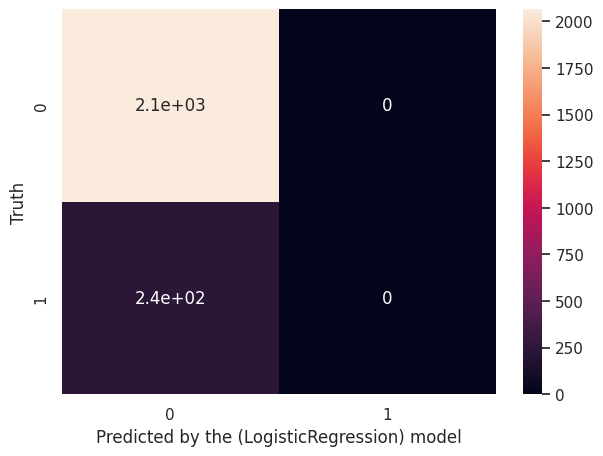

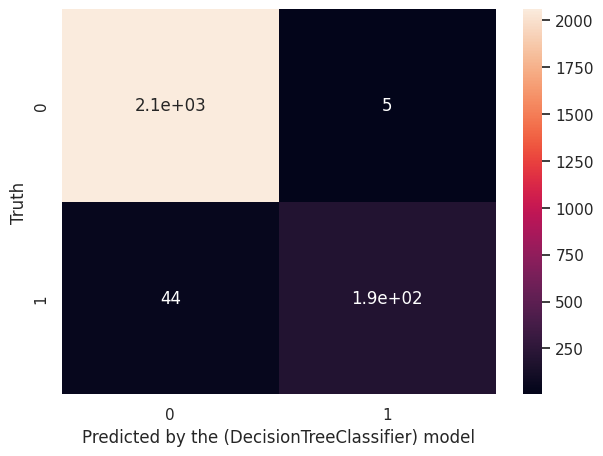

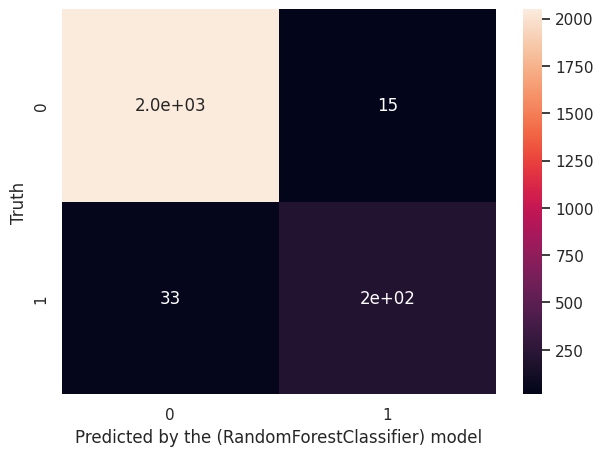

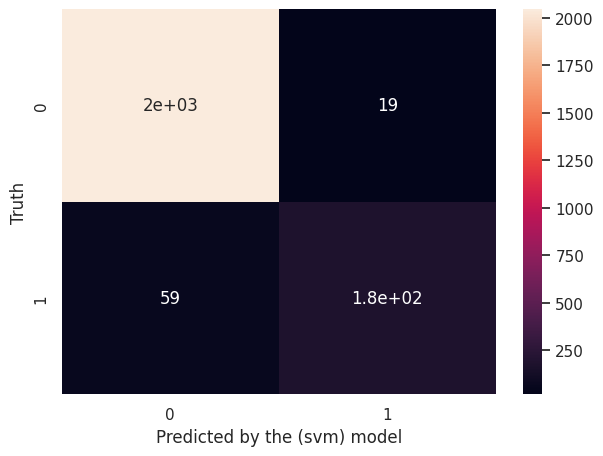

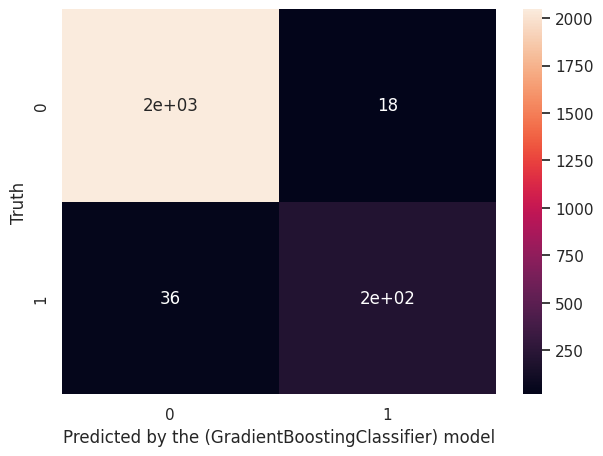

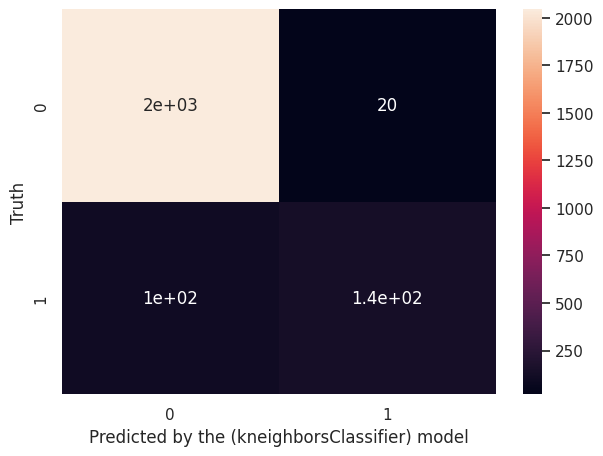

In [46]:
for model_name, model in models.items():
    # Fit the model to the training data
    model.fit(x_train, y_train)
    
    # Make predictions on the test & train data
    y_pred = model.predict(x_test)
    y_train_pred = model.predict(x_train)
    
    # calc acc Score on test & train data :
    acc_train = model.score(x_train, y_train)
    # calc mean square error on train & test data :
    
    mse_train = mean_squared_error(y_train, y_train_pred)
    mse_test = mean_squared_error(y_test, y_pred)
    
    
    # Evaluate the model
    mse = metrics.mean_squared_error(y_test, y_pred)
    acc = model.score(x_test,y_test)
    f1 = f1_score(y_test, y_pred, average='binary')
    auc_score = roc_auc_score(y_test, y_pred)
    precision = precision_score(y_test, y_pred, average='macro')
    recall = recall_score(y_test, y_pred, average='macro')
    print("="*60)
    
    
    model_evaluation_metrics = {}
    # Calculate confusion matrix and classification report
    cm = confusion_matrix(y_test, y_pred)
    classif_report = classification_report(y_test, y_pred)
    # Storing the results
    model_evaluation_metrics[model_name] = {
        "Confusion Matrix":cm,
        'Classification Report': classif_report
    }
    
    plt.figure(figsize=(7,5))
    sns.heatmap(cm,annot=True)
    plt.xlabel(f"Predicted by the ({model_name}) model")
    plt.ylabel('Truth'),
    
    # Print the evaluation metrics for each model
    
    print(f"Model: {model_name}")
    print(f"Mean Squared Error (MSE): {mse}")
    
    print(f"acc_train: {acc_train*100:0.2f}%")
    print(f"acc_model: {acc*100:0.2f}%")
    print(f"f1_model: {f1*100:0.2f}%")
    print(f"auc_model: {auc_score*100:0.2f}%")
    print(f"precision: {precision*100:0.2f}%")
    print(f"recall: {recall*100:0.2f}%")
    
    print(f"Mean Squared Error train data (MSE): {mse_train}")
    print(f"Mean Squared Error test data (MSE): {mse_test}")
    print("\nClassification Report:")
    print(classif_report)
    print("\n" + "="*60 + "\n")
   
    

## Comparsion between Actual & Predicted values for Every Model 📝📝📝

In [47]:
# Actual & predictions values for every modele :

for model_name, model in models.items():
     
    model.fit(x_train, y_train)
    y_pred = model.predict(x_test)
    print(f"👉🏻Model: {model_name}")
    # Create a dataframe to display actual and predicted values
    df = pd.DataFrame({'Actual': y_test, 'Predicted': y_pred})
    print(df.head(10))
    print("=" * 70)

👉🏻Model: LogisticRegression
      Actual  Predicted
6456     1.0        0.0
3333     1.0        0.0
5728     0.0        0.0
5391     0.0        0.0
1731     0.0        0.0
7243     0.0        0.0
4615     0.0        0.0
6951     0.0        0.0
37       0.0        0.0
3955     0.0        0.0
👉🏻Model: DecisionTreeClassifier
      Actual  Predicted
6456     1.0        1.0
3333     1.0        1.0
5728     0.0        0.0
5391     0.0        0.0
1731     0.0        0.0
7243     0.0        0.0
4615     0.0        0.0
6951     0.0        0.0
37       0.0        0.0
3955     0.0        0.0
👉🏻Model: RandomForestClassifier
      Actual  Predicted
6456     1.0        1.0
3333     1.0        1.0
5728     0.0        0.0
5391     0.0        0.0
1731     0.0        0.0
7243     0.0        0.0
4615     0.0        0.0
6951     0.0        0.0
37       0.0        0.0
3955     0.0        0.0
[CV] END ...............n_neighbors=1, p=2, weights=distance; total time=   0.0s
[CV] END ................n_neighbor

<p> &bull; <span class="label label-default" style="background-color:#DC1010; border-radius:12px; font-weight: bold; font-family:Verdana; font-size:28px; color:#FBFAFC; ">  Get feature importances for Decision Tree Classifier 🎄</span>  </p> 

In [48]:

font_properties = {
    'family': 'serif',
    'color': 'green',
    'weight': 'bold',
    'size': 45}

decision_tree_model = models["DecisionTreeClassifier"]
plt.figure(figsize=(95,85),dpi=150)  # Adjust figure size as needed
tree.plot_tree(decision_tree_model, filled=True, feature_names=x_class.columns, node_ids=True, fontsize=42)  # Control node size with fontsize
plt.title("Decision Tree",fontdict=font_properties)
plt.show()


In [49]:
feature_importances1 = decision_tree_model.feature_importances_
feature_names = x_class.columns

# Create a DataFrame to display feature importances
importance_df = pd.DataFrame({'Feature': feature_names, 'Importance': feature_importances1})
importance_df = importance_df.sort_values(by='Importance', ascending=False)
importance_df.style.background_gradient(cmap="Blues")

,Feature,Importance
2,vibration,0.507739
0,temperature,0.393675
1,pressure,0.072108
3,humidity,0.024097
4,equipment,0.001897
5,location,0.000483


<p> &bull; <span class="label label-default" style="background-color:#DC1010; border-radius:12px; font-weight: bold; font-family:Verdana; font-size:28px; color:#FBFAFC; ">Random Forest Classifier 🎄🎄🎄</span>  </p>


In [56]:
best_estimator = gridsearch1.best_estimator_
print("Best estimator:", best_estimator)
print("best estimator=",best_estimator)
feature_importances2 = best_estimator.feature_importances_
feature_names = x_class.columns

# Create a DataFrame to display feature importances

importance_df = pd.DataFrame({'Feature': feature_names, 'Importance': feature_importances2})
importance_df = importance_df.sort_values(by='Importance', ascending=False)
importance_df.style.background_gradient(cmap="Oranges")

Best estimator: RandomForestClassifier(max_depth=180, max_features=2, n_estimators=160)
best estimator= RandomForestClassifier(max_depth=180, max_features=2, n_estimators=160)


,Feature,Importance
0,temperature,0.338283
2,vibration,0.336370
1,pressure,0.195715
3,humidity,0.112894
5,location,0.009806
4,equipment,0.006931


<p> &bull; <span class="label label-default" style="background-color:#DC1010; border-radius:12px; font-weight: bold; font-family:Verdana; font-size:28px; color:#FBFAFC; ">GradientBoostingClassifier🌲🚀</span>  </p>

In [51]:
best_estimator = gridsearch2.best_estimator_
print("Best estimator:", best_estimator)
print("best estimator=",best_estimator)
feature_importances3 = best_estimator.feature_importances_
feature_names = x_class.columns

# Create a DataFrame to display feature importances

importance_df = pd.DataFrame({'Feature': feature_names, 'Importance': feature_importances3})
importance_df = importance_df.sort_values(by='Importance', ascending=False)
importance_df.style.background_gradient(cmap="Reds")

best estimator= GradientBoostingClassifier(max_depth=200, max_features=3)


,Feature,Importance
2,vibration,0.379033
0,temperature,0.330397
1,pressure,0.167275
3,humidity,0.109060
5,location,0.008486
4,equipment,0.005749


<p> &bull; <span class="label label-default" style="background-color:#DC1010; border-radius:12px; font-weight: bold; font-family:Verdana; font-size:28px; color:#FBFAFC; ">LogisticRegression 📊📈</span>  </p> 

In [58]:
best_estimator = gridsearch3.best_estimator_
print("Best estimator:", best_estimator)

coefficients = best_estimator.coef_[0] # iused coffients of logistic to determine importances
feature_names = x_class.columns

feature_importances = pd.DataFrame({
    'Feature': feature_names,
    'Importance': coefficients})

feature_importances = feature_importances.sort_values(by='Importance', ascending=False)
feature_importances.style.background_gradient(cmap="Greens")


Best estimator: LogisticRegression(C=0.1, max_iter=1000)


,Feature,Importance
2,vibration,2.171854
0,temperature,0.690907
1,pressure,0.601100
3,humidity,0.227861
5,location,0.212727
4,equipment,-0.045336


<p> &bull; <span class="label label-default" style="background-color:#DC1010; border-radius:12px; font-weight: bold; font-family:Verdana; font-size:28px; color:#FBFAFC; ">svm 📚📚📚 <span>  </p> 

In [59]:
# Extract the best estimator, parameters, and score from GridSearch
best_estimator = gridsearch4.best_estimator_
print("Best estimator:", best_estimator)
best_params = gridsearch4.best_params_
best_score = gridsearch4.best_score_

# Create a DataFrame for the best model summary :
best_model = pd.DataFrame({
    'Metric': ['Best Estimator', 'Best Parameters', 'Best Score'],
    'Result': [str(best_estimator), str(best_params), best_score]
})


styled_best_model = best_model.style.background_gradient(cmap="Oranges")
styled_best_model




Best estimator: SVC(C=100, gamma=0.2)


,Metric,Result
0,Best Estimator,"SVC(C=100, gamma=0.2)"
1,Best Parameters,"{'C': 100, 'gamma': 0.2, 'kernel': 'rbf'}"
2,Best Score,0.964060


<p> &bull; <span class="label label-default" style="background-color:#DC1010; border-radius:12px; font-weight: bold; font-family:Verdana; font-size:28px; color:#FBFAFC; ">KneighborsClassifier 🧠👥</span> </p>


In [61]:
best_estimator = gridsearch5.best_estimator_
print("Best estimator:", best_estimator)


Best estimator: KNeighborsClassifier(n_neighbors=4, p=1, weights='distance')


<span class="label label-default" style="background-color:#d35400; border-radius:12px; font-weight: bold; font-family:Verdana; font-size:28px; color:#FBFAFC;">Result 📚📚📚📚📚</span>

<div style="background-color:#ecf0f1; color:#cb4335; padding:10px; border-radius:12px; margin-bottom:10px;">
  <p><strong>Model:</strong> GradientBoostingClassifier🌲🚀</p>
  <p><strong>Model Accuracy:</strong>  88.16%</p>
</div>

<div style="background-color:#ecf0f1; color:#17202a; padding:10px; border-radius:12px; margin-bottom:10px;">
  <p><strong>Model:</strong> SVM 📚</p>
  <p><strong>Model Accuracy:</strong>82.03%%</p>
</div>

<div style="background-color:#ecf0f1; color:#cb4335; padding:10px; border-radius:12px; margin-bottom:10px;">
  <p><strong>Model:</strong> RandomForestClassifier 🎄🎄🎄</p>
  <p><strong>Model Accuracy:</strong> 89.47%</p>
</div>

<div style="background-color:#ecf0f1; color:#3498db; padding:10px; border-radius:12px; margin-bottom:10px;">
  <p><strong>Model:</strong> DecisionTreeClassifier 🎄</p>
  <p><strong>Model Accuracy:</strong> 88.74%</p>
</div>

<div style="background-color:#ecf0f1; color:#d35400; padding:10px; border-radius:12px; margin-bottom:10px;">
  <p><strong>Model:</strong> LogisticRegression📊📈</p>
  <p><strong>Model Accuracy:</strong> 89.70%</p>
</div>

<div style="background-color:#ecf0f1; color:#d35400; padding:10px; border-radius:12px; margin-bottom:10px;">
  <p><strong>Model:</strong>KneighborsClassifier 🧠👥</p>
  <p><strong>Model Accuracy:</strong>  69.21%</p>
</div>

<span class="label label-default" style="background-color:#DC1010; border-radius:12px; font-weight: bold; font-family:Verdana; font-size:28px; color:#FBFAFC;">Saving & Load the best Model  📚📚📚📚📚</span>


In [63]:
import pickle 
with open('RandomForestClassifier.sav', 'wb') as file:
    pickle.dump(RandomForestClassifier, file)

with open('RandomForestClassifier.sav', 'rb') as file:
    my_object_loaded = pickle.load(file)
print("Model Saved .......")    

Model Saved .......


## Deployment Stage , The Next Step 🏭 :

In [64]:
# Load the model
Data = pickle.load(open("RandomForestClassifier.sav", "rb"))
Data

sklearn.ensemble._forest.RandomForestClassifier

## Created By  : Eng/AbdalRhman Gameel Ahmed Hebishy 


<div style="border: 5px solid yellow; padding: 10px; background-color: #F5F5DC; color: blue; border-radius: 30px 45px 30px 45px;">


<img src="https://t4.ftcdn.net/jpg/04/00/26/99/360_F_400269908_gDF8JR2ctyHWiL1kww6WEWBerRzD5MBb.jpg" alt="My Image">

<p>&bull;  AbdalRhman Hebishy , DataScientist||Machine learning||Deeplearning Engineer 💻💻 .</p>

<p>&bull; <a href="https://www.kaggle.com/abdalrhamnhebishy" target="_blank">Kaggle profile 🔍</a>.</p>

<p>&bull; <a href="https://github.com/AbdalRahmna " target="_blank">Github profile 🐱</a>.</p>

<p>&bull; <a href="https://www.linkedin.com/in/abdalrahman-hebishy-06465b254/"_blank">linkedin profile 🧑‍💼</a>.</p>


</div>
